# IRI Calculation from Road Profiles
An instructional tool for calculating IRI from road profiles and visualizing the motion of the quarter car model. Written for instructional purposes only. You do not need to know Python to use this tool. Follow instructions and click on the arrow symbol next to each cell to execute said cell.

IRI is calculated using Sroubek, M. Sorel, J. Zak: Precise International Roughness Index Calculation. Int. J. Pavement Res. Technol. (2021) [github.com/michalsorel](https://github.com/michalsorel/iri). Springs were drawn using
[github.com/nrsyed](https://github.com/nrsyed/utilities/tree/master/spring).

For source code, visit [github/egemenokte](https://github.com/egemenokte)

## International Roughness Index (IRI)

The **International Roughness Index (IRI)** measures road surface smoothness, utilizing the response of a standardized vehicle model (often referred to as the "Golden Car") to the road's roughness. It's expressed in both meters per kilometer (m/km) and inches per mile (in/mi), serving as a critical indicator of road quality. Key factors influenced by IRI include ride comfort, vehicle longevity, and fuel consumption efficiency.

### Calculation of IRI

The IRI calculation employs the Quarter-Car Model to simulate the response of a reference vehicle, typically traveling at a standardized speed of 80 km/h (approximately 50 mph), across the road surface. The calculation integrates the absolute difference between the displacements of the sprung and unsprung masses over the road segment under evaluation. Incorporating time derivatives of these displacements, the formula is given as:

$$ IRI = \frac{1}{L} \int_0^{L/V} \left| \dot{z}_s - \dot{z}_u \right| dt $$

where:
- $L$ is the length of the road segment,
- $V$ denotes the vehicle's travel speed, set to 80 km/h (or 50 mph for conversions),
- $\dot{z}_s$ represents the time derivative (rate of change) of the sprung mass displacement,
- $\dot{z}_u$ is the time derivative (rate of change) of the unsprung mass displacement,
- $t$ is the time variable.

This equation quantitatively assesses the road's roughness by analyzing the vertical movements of the vehicle's body (sprung mass) and wheel assembly (unsprung mass), offering a comprehensive view of the road surface's smoothness.


# Import packages and connect to Github

In [14]:
!git clone https://github.com/egemenokte/PavementPython.git
%cd PavementPython/IRIPython
from IPython.display import clear_output
clear_output()
print('All good, move to next step')

All good, move to next step


animate function is used to animate the quarter car model at the end

In [15]:
import python.iri as Rough
import python.roadprofile as RoadProfile
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rc
from IPython.display import HTML
from matplotlib import animation
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Ellipse, Circle, Rectangle
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import seaborn as sns
from PIL import Image
import warnings
sns.set()
#mpl.rcParams['animation.embed_limit'] = 2**20 # This sets the limit to 2^x bytes
warnings.filterwarnings("ignore")
def animateIRI(ZZ,resx=20,usdist=0.15/2,sdist=0.2,frames=500,interval=20,watermark=True):
  '''
  Inputs:
  ZZ -  Location of unsprung and sprung mass, as well as the road profile
  resx - total distance to plot in x (m)
  usdist - unsprung mass distance from road (m)
  sdist - sprung mass distance from road (m)
  frames - number of frames to animate
  interval - time between frames in ms

  Output:
  animation object
  '''
  from matplotlib.animation import FuncAnimation
  from matplotlib.patches import  Rectangle
  plt.close('all')

  # sns.set()
  #save=save
  resx=resx # total x distance of plot  (m)
  usdist=usdist #unsprung mass distance from road (m)
  sdist=sdist # sprung mass distance from road
  distbet=sdist-usdist
  US=ZZ[:,1]+usdist
  S=ZZ[:,0]+sdist
  US=US
  S=S
  X=ZZ[:,2]
  R=ZZ[:,3]
  dif=X[1]-X[0]
  max_i = len(ZZ) - 1 - int(resx / dif)
  # Adjust frames to not exceed max_i or the user's input
  frames = min(frames, max_i)
  IRIi=ZZ[:,4]
  IRIc=np.cumsum(IRIi)/(np.arange(len(IRIi))+1)
  fig, ax = plt.subplots(figsize=(7,5),dpi=130);

  def animate(i):

      ax.clear()
      Xp=X[max(0,i-int(resx/dif)):i+int(resx/dif)+1]
      Rp=R[max(0,i-int(resx/dif)):i+int(resx/dif)+1]
      ax.fill(np.append(Xp,[max(Xp),min(Xp)]), np.append(Rp,[min(Rp)-0.1,min(Rp)-0.1]),color='dimgray') #draw the road
      x,y=Rough.spring((X[i], R[i]),(X[i], US[i]),8,resx/20) #draw the first spring from road to unsprung
      ax.plot(x,y,color='grey',zorder=1)
      x,y=Rough.spring((X[i]-resx/10*3/5, US[i]),(X[i]-resx/10*3/5, S[i]),10,resx/20) #second spring between masses
      ax.plot(x,y,color='grey',zorder=1)

      ax.plot([X[i]+resx/10*3/5, X[i]+resx/10*3/5],[US[i],US[i]+distbet/2],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5-resx/40, X[i]+resx/10*3/5+resx/40],[US[i]+distbet/2,US[i]+distbet/2],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5, X[i]+resx/10*3/5],[S[i],S[i]-distbet/2*0.6],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5-resx/30, X[i]+resx/10*3/5+resx/30],[S[i]-distbet/2*0.6,S[i]-distbet/2*0.6],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5-resx/30, X[i]+resx/10*3/5-resx/30],[S[i]-distbet/2*0.6,S[i]-distbet/2*1.2],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5+resx/30, X[i]+resx/10*3/5+resx/30],[S[i]-distbet/2*0.6,S[i]-distbet/2*1.2],color='grey',zorder=1)

      ax.scatter(X[i], R[i],color='black',zorder=2) # draw a ball on the road profile
      ax.plot(X[i-int(resx/dif):i+1], US[i-int(resx/dif):i+1],zorder=1,color='midnightblue') #unsprung mass history
      ax.plot(X[i-int(resx/dif):i+1], S[i-int(resx/dif):i+1],zorder=1,color='darkred') #sprung mass history

      ax.add_patch(Rectangle((X[i]-resx/10, US[i]-sdist/20), resx/5, sdist/10,color='midnightblue')) #unsprung mass
      ax.add_patch(Rectangle((X[i]-resx/10, S[i]-sdist/20), resx/5, sdist/10,color='darkred')) #sprung mass

      ax.text(X[max(0,i-int(resx/dif))]+sdist/2, R[i]-sdist/2.1, f"IRI Instant. = {np.round(IRIi[i],1)} m/km", size=15, color='Black')
      ax.text(X[max(0,i-int(resx/dif))]+sdist/2, R[i]+sdist*1.5, f"IRI Overall = {np.round(IRIc[i],1)} m/km", size=15, color='Black')


      ax.set_xlim([X[max(0,i-int(resx/dif))],X[i+int(resx/dif)]])
      ax.set_ylim([R[i]-sdist/2,R[i]+sdist*3/2])
      ax.grid(False)

      # Hide axes ticks
      ax.set_xticks([])
      ax.set_yticks([])
      ax.set_xticks([X[max(0,i-int(resx/dif))],X[i+int(resx/dif)]],['',str(2*resx)+'m'])
      # implot = plt.imshow(im,aspect='auto',zorder=0,extent=[X[max(0,i-int(resx/dif))],X[i+int(resx/dif)], R[i]-0.1, R[i]+0.3])

      if watermark:
        # Load and add the watermark image outside the animate function
        img_path = 'python/UM.png'  # or 'python/picture.svg' for SVG
        image = plt.imread(img_path)
        imagebox = OffsetImage(image, zoom=0.2)  # Adjust zoom as needed
        ab = AnnotationBbox(imagebox, (0.97, 0.97), xycoords='axes fraction', boxcoords="axes fraction",
                            box_alignment=(0.97, 0.97), frameon=False)
        ax.add_artist(ab)
        ab.set_zorder(10)
  ani = FuncAnimation(fig, animate, frames=frames, interval=interval, repeat=True,repeat_delay = 300);


  plt.close('all')
  return ani



def generate_road_profile(length=1000, scale=0.02, sampling_interval=0.25, wavelength=4, psd_slope=-2, seed=None):

      # Set the seed for reproducibility
    if seed is not None:
        np.random.seed(seed)

    frequencies = np.fft.rfftfreq(int(length / sampling_interval), d=sampling_interval)
    omega = 2 * np.pi * frequencies  # angular frequency

    # Avoid division by zero for the first element by starting calculation from the second element
    psd = np.zeros_like(omega)
    psd[1:] = (omega[1:] ** psd_slope) * np.exp(-omega[1:] / (2 * np.pi / wavelength))
    psd[0] = 0  # Explicitly set the PSD at zero frequency to zero
    psd = psd * scale

    # Generate random phase
    random_phase = np.exp(1j * np.random.uniform(0, 2 * np.pi, size=len(psd)))

    # Inverse FFT to get the road profile
    road_profile_complex = np.sqrt(psd) * random_phase
    road_profile = np.fft.irfft(road_profile_complex)
    road_profile_array = np.column_stack((np.arange(0, length, sampling_interval)[:len(road_profile)], road_profile))

    # Plot
    plt.figure(figsize=(10, 4))
    plt.plot(np.arange(0, length, sampling_interval)[:len(road_profile)], road_profile * 1000)
    plt.title('Synthesized Road Profile')
    plt.xlabel('Distance (m)')
    plt.ylabel('Elevation (mm)')
    plt.grid(True)
    plt.show()

    return road_profile_array

# Parameters for the function
road_length = 100  # meters
scale = 0.02  # PSD scale

# Run the function
road_profile_array = generate_road_profile(road_length, scale)

clear_output()
print('All good, move to next step')

All good, move to next step


# Calculating IRI Based on Actual Road Profile
Read the road profile and analyze IRI. By default, you can choose between Profile_0, Profile_1 and Profile_2. You can also change to code to run your own profile.

Parameter start_pos does not exist, set to the first sample.
IRI computation
----------------------------------------
Regular sampling: 0.25 m
Samples are more than 0.125 m from each other, box filter not needed, skipped...
Segment length: 20 m
Starting position: 0.0 m
Method: 2
Number of segments: 7
Mean IRI = 1.42 m/km


<Figure size 640x480 with 0 Axes>

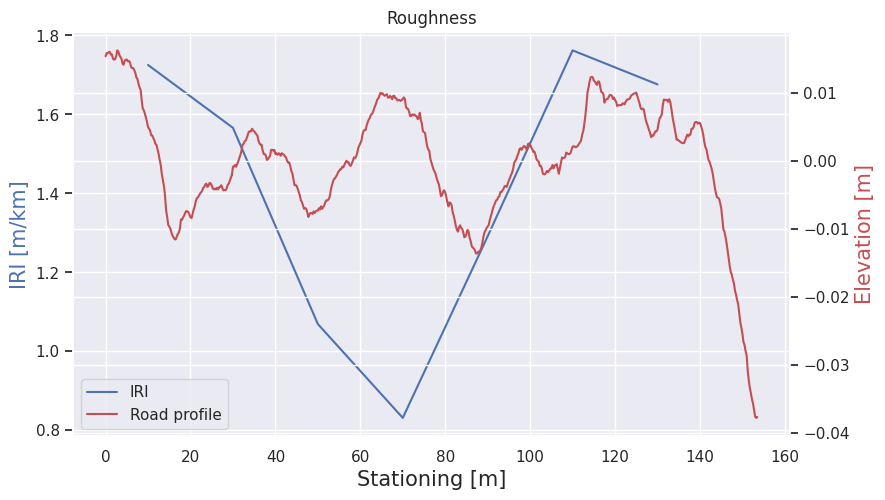

<Figure size 640x480 with 0 Axes>

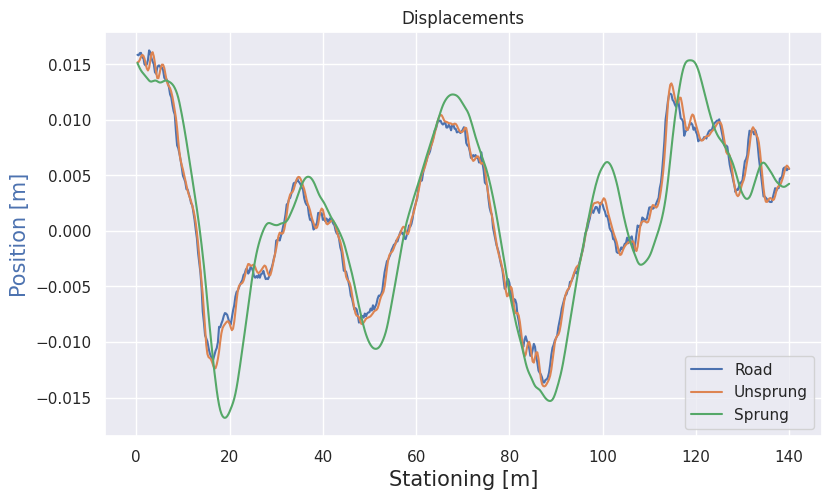

In [16]:
# Read road profile data from an Excel file, averaging values over a 0.25m interval,
# which is commonly used in International Roughness Index (IRI) calculations.
road_profile = Rough.readxlsx('Profiles/Profile_0.xlsx', stick=0.25)

############################################################################
# Calculate the International Roughness Index (IRI) for the road profile.
# - segment_length: The length of road segments, in meters, over which IRI is calculated.
# - start_pos: Starting position for IRI calculation. A value of -1 indicates the start of the profile.
# - step: The step size for moving along the profile. A value of 0 calculates IRI for the entire segment only once.
# - box_filter: Applies a box filter to smooth the profile if True.
# - method: The numerical method used for IRI calculation, with 2 indicating a specific algorithm.
IRI, equidistant, ZZ = Rough.iri(road_profile, segment_length=20, start_pos=-1, step=0, box_filter=True, method=2)

# Print the mean IRI value calculated over the profile, formatted to two decimal places.
print(f'Mean IRI = {np.mean(IRI[:,2]):.2f} m/km')

# Close all previously opened plot windows to ensure a clean slate for new plots.
plt.close('all')

# Plot the IRI results alongside the road profile.
# - The title 'Roughness' is assigned to the plot for clarity.
plt.figure()
Rough.plot_iri(IRI, road_profile, 'Roughness')

# Plot the mass displacements used in the golden car model for roughness assessment.
# - The title 'Displacements' is given to the plot for clarity.
plt.figure()
Rough.plot_mass(ZZ, 'Displacements')

## Animation
Animate the quarter car model. You can see optional parameters where function animateIRI is defined

In [20]:
print('Please wait for animation to be rendered. It can take a while.')
rc('animation', html='jshtml');
ani=animateIRI(ZZ,resx=20,usdist=0.15/2,sdist=0.2,frames=500,interval=30) #Higher the frames, higher the render time!
ani

Please wait for animation to be rendered. It can take a while.


# Calculating IRI Based on Synthetic Road Profile
Create a synthetic road profile based on power spectral density of the road and calculate IRI. length is the length to be generated (in m). Scale controls the IRI level. Other parameters are set to default values.

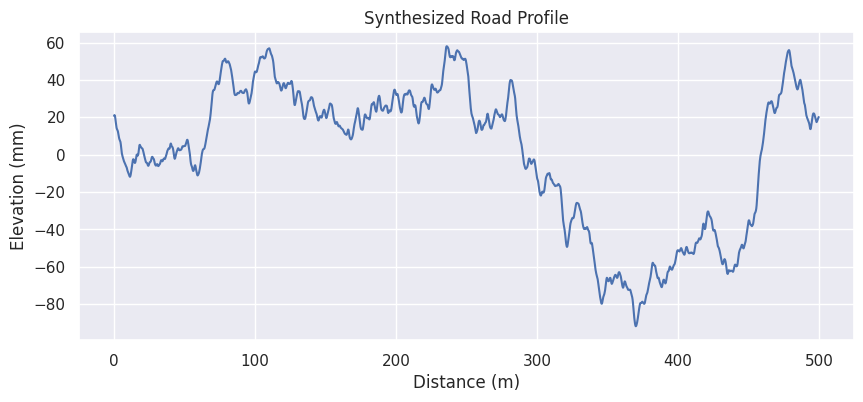

Parameter start_pos does not exist, set to the first sample.
IRI computation
----------------------------------------
Regular sampling: 0.25 m
Samples are more than 0.125 m from each other, box filter not needed, skipped...
Segment length: 20 m
Starting position: 0.0 m
Method: 2
Number of segments: 24
Mean IRI = 3.16 m/km


<Figure size 640x480 with 0 Axes>

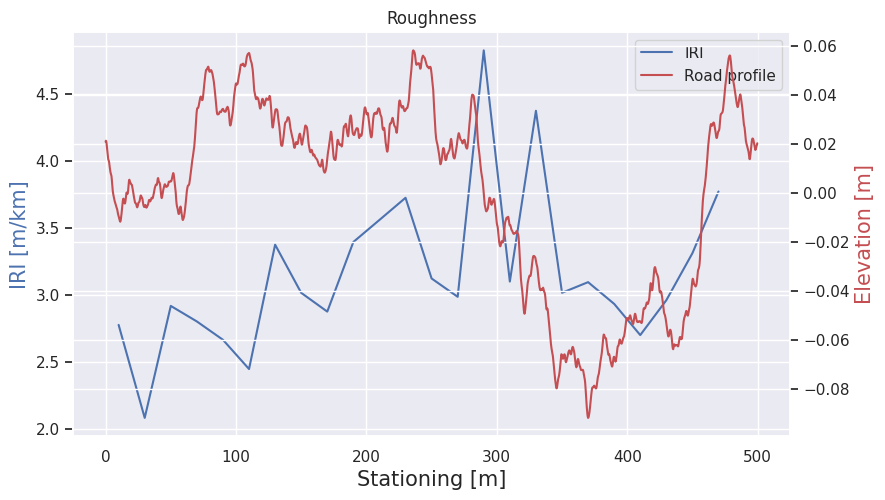

<Figure size 640x480 with 0 Axes>

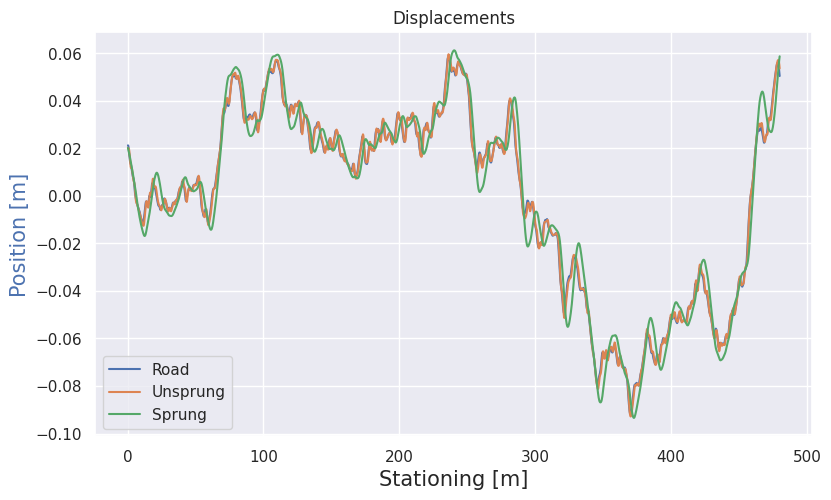

In [18]:
# Generate a synthetic road profile with specified parameters, including road length, PSD scale,
# sampling interval, wavelength, PSD slope, and a seed for reproducibility
road_synthetic = generate_road_profile(length=500, scale=0.3, sampling_interval=0.25, wavelength=6, psd_slope=-2, seed=1)

###############################################################################
# Calculate the International Roughness Index (IRI) for the synthetic road profile.
# This includes the use of segment length for IRI calculation, with parameters for start position,
# step size, a box filter, and the method used for calculation.
IRIS, equidistantS, ZZS = Rough.iri(road_synthetic, segment_length=20, start_pos=-1, step=0, box_filter=True, method=2)

# Print the mean IRI value, converting it to meters per kilometer for readability.
print(f'Mean IRI = {np.mean(IRIS[:,2]):.2f} m/km')

# Plot the IRI results for the synthetic road profile. This visualizes how roughness varies along the road.
plt.figure()
Rough.plot_iri(IRIS, road_synthetic, 'Roughness')

# Plot displacement results for the synthetic road. These results are based on simulations that
# estimate how much a "golden car" model would be displaced by the road's roughness.
plt.figure()
Rough.plot_mass(ZZS, 'Displacements')

## Animation
Animate the quarter car model. You can see optional parameters where the function animateIRI is defined

In [ ]:
print('Please wait for animation to be rendered. It can take a while.')
rc('animation', html='jshtml');
aniS=animateIRI(ZZS,resx=20,usdist=0.15/2,sdist=0.2,frames=300,interval=30) #Higher the frames, higher the render time!
aniS